## Khởi tạo

In [1]:
import sys,os
__script_path=os.path.abspath(globals().get('__file__','.'))
__script_dir = os.path.dirname(__script_path)
root_dir = os.path.abspath(f'{__script_dir}/..')
print(root_dir)
for lib in [root_dir][::-1]:
    if lib in sys.path:
        sys.path.remove(lib)
    sys.path.insert(0,lib)


c:\Users\Admin\Data\WDM-AI-TEMIS


In [2]:
from configs.config import *
from libs.common import *
from utils.format_utils import *
# from utils.extract_tables import full_pipeline
from utils.rag_evaluation import *
from utils.rag_qdrant_utils import *
load_dotenv(find_dotenv())

c:/Users/Admin/Data/WDM-AI-TEMIS
root_dir: c:/Users/Admin/Data/WDM-AI-TEMIS
c:/Users/Admin/Data/WDM-AI-TEMIS/data


c:\Users\Admin\Data\WDM-AI-TEMIS\.venv\lib\site-packages\tqdm\auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm
2025-06-21 23:10:00.404 | WARNING  | fastembed.embedding:<module>:7 - DefaultEmbedding, FlagEmbedding, JinaEmbedding are deprecated.Use from fastembed import TextEmbedding instead.


True

In [3]:
os.makedirs(exps_dir, exist_ok=True)

In [4]:
mongo_uri = os.getenv('MONGO_URI')
GEMINI_API_KEY = os.getenv('GEMINI_API_KEY')
QUOTIENTAI = os.getenv('QuotientAI')
collection = "kyanon_digital"

# mongo_client = get_mongo_client(mongo_uri)
# db = mongo_client['Kyanon']
# collection = db['RAG']
collection_name = "kyanon_digital"
QUOTIENT_API_KEY = os.getenv('QUOTIENT_API_KEY')

In [5]:
exps_dir

'c:/Users/Admin/Data/WDM-AI-TEMIS/exps'

In [6]:
import torch
torch.cuda.is_available()

True

In [7]:
##Uncomment to initialise qdrant client in memory
# client.close()
client = qdrant_client.QdrantClient(
   path=f"{exps_dir}/qdrant_client_memory",
)

# ##Uncomment below to connect to Qdrant Cloud
# client = qdrant_client.QdrantClient(
#     os.environ.get("QDRANT_URL"),
#     api_key=os.environ.get("QDRANT_API_KEY"),
# )

## Uncomment below to connect to local Qdrant
#client = qdrant_client.QdrantClient("http://localhost:6333")

In [8]:
from fastembed.embedding import TextEmbedding

data=pd.DataFrame(TextEmbedding.list_supported_models())
data

,model,sources,model_file,description,license,size_in_GB,additional_files,dim,tasks
0,BAAI/bge-base-en,"{'hf': 'Qdrant/fast-bge-base-en', 'url': 'http...",model_optimized.onnx,"Text embeddings, Unimodal (text), English, 512...",mit,0.420,[],768,{}
1,BAAI/bge-base-en-v1.5,"{'hf': 'qdrant/bge-base-en-v1.5-onnx-q', 'url'...",model_optimized.onnx,"Text embeddings, Unimodal (text), English, 512...",mit,0.210,[],768,{}
2,BAAI/bge-large-en-v1.5,"{'hf': 'qdrant/bge-large-en-v1.5-onnx', 'url':...",model.onnx,"Text embeddings, Unimodal (text), English, 512...",mit,1.200,[],1024,{}
3,BAAI/bge-small-en,"{'hf': 'Qdrant/bge-small-en', 'url': 'https://...",model_optimized.onnx,"Text embeddings, Unimodal (text), English, 512...",mit,0.130,[],384,{}
4,BAAI/bge-small-en-v1.5,"{'hf': 'qdrant/bge-small-en-v1.5-onnx-q', 'url...",model_optimized.onnx,"Text embeddings, Unimodal (text), English, 512...",mit,0.067,[],384,{}
5,BAAI/bge-small-zh-v1.5,"{'hf': 'Qdrant/bge-small-zh-v1.5', 'url': 'htt...",model_optimized.onnx,"Text embeddings, Unimodal (text), Chinese, 512...",mit,0.090,[],512,{}
6,mixedbread-ai/mxbai-embed-large-v1,"{'hf': 'mixedbread-ai/mxbai-embed-large-v1', '...",onnx/model.onnx,"Text embeddings, Unimodal (text), English, 512...",apache-2.0,0.640,[],1024,{}
7,snowflake/snowflake-arctic-embed-xs,"{'hf': 'snowflake/snowflake-arctic-embed-xs', ...",onnx/model.onnx,"Text embeddings, Unimodal (text), English, 512...",apache-2.0,0.090,[],384,{}
8,snowflake/snowflake-arctic-embed-s,"{'hf': 'snowflake/snowflake-arctic-embed-s', '...",onnx/model.onnx,"Text embeddings, Unimodal (text), English, 512...",apache-2.0,0.130,[],384,{}
9,snowflake/snowflake-arctic-embed-m,"{'hf': 'Snowflake/snowflake-arctic-embed-m', '...",onnx/model.onnx,"Text embeddings, Unimodal (text), English, 512...",apache-2.0,0.430,[],768,{}


In [9]:
data.model.unique()

array(['BAAI/bge-base-en', 'BAAI/bge-base-en-v1.5',
       'BAAI/bge-large-en-v1.5', 'BAAI/bge-small-en',
       'BAAI/bge-small-en-v1.5', 'BAAI/bge-small-zh-v1.5',
       'mixedbread-ai/mxbai-embed-large-v1',
       'snowflake/snowflake-arctic-embed-xs',
       'snowflake/snowflake-arctic-embed-s',
       'snowflake/snowflake-arctic-embed-m',
       'snowflake/snowflake-arctic-embed-m-long',
       'snowflake/snowflake-arctic-embed-l', 'jinaai/jina-clip-v1',
       'Qdrant/clip-ViT-B-32-text',
       'sentence-transformers/all-MiniLM-L6-v2',
       'jinaai/jina-embeddings-v2-base-en',
       'jinaai/jina-embeddings-v2-small-en',
       'jinaai/jina-embeddings-v2-base-de',
       'jinaai/jina-embeddings-v2-base-code',
       'jinaai/jina-embeddings-v2-base-zh',
       'jinaai/jina-embeddings-v2-base-es', 'thenlper/gte-base',
       'thenlper/gte-large', 'nomic-ai/nomic-embed-text-v1.5',
       'nomic-ai/nomic-embed-text-v1.5-Q', 'nomic-ai/nomic-embed-text-v1',
       'sentence-transfor

In [10]:
# client.create_collection(
#     collection_name='kyanon_digital',
#     vectors_config=VectorParams(size=768, distance=Distance.COSINE),
# )
client.get_collections()


CollectionsResponse(collections=[CollectionDescription(name='experiment_512_128_gte-base'), CollectionDescription(name='experiment_512_128_bge-base-en'), CollectionDescription(name='experiment_512_128_jina-embeddings-v2-base-en'), CollectionDescription(name='experiment_512_128_paraphrase-multilingual-MiniLM-L12-v2'), CollectionDescription(name='experiment_1024_128_models/embedding-001'), CollectionDescription(name='experiment_1024_128_embedding-001'), CollectionDescription(name='experiment_hybridsearch_tfidf_512_128_gte-base'), CollectionDescription(name='experiment_512_128_gte-base_recursive'), CollectionDescription(name='experiment_512_128_gte-base_character'), CollectionDescription(name='experiment_512_128_gte-base_semantic'), CollectionDescription(name='experiment_512_128_gte-base_character_hybrid'), CollectionDescription(name='experimenthybrid'), CollectionDescription(name='experiment_hybrid_512_128_gte-base_character'), CollectionDescription(name='experiment_hybrid_512_128_bge-ba

In [11]:
# info = client.get_collection(collection_name="experiment_512_128_gte-base")
# print(info)

In [12]:
import requests
import json

def summary_fn(prompt):
    """
    Gửi prompt đến Ollama và nhận về một đoạn phản hồi hoàn chỉnh.
    
    Tham số:
        prompt (str): Câu hỏi hoặc yêu cầu bạn muốn gửi đến mô hình.

    Trả về:
        str: Phản hồi hoàn chỉnh từ mô hình.
    """
    response = requests.post(
  url="https://openrouter.ai/api/v1/chat/completions",
  headers={
    "Authorization": f"Bearer {os.getenv('API_OPENROUTE')}",
    "Content-Type": "application/json",
  },
  data=json.dumps({
    "model": "mistralai/devstral-small:free",
    "messages": [
      {
        "role": "user",
        "content": [
          {
            "type": "text",
            "text": f"""
    You are given a single table fragment extracted from a PDF document using OCR. This fragment may be part of a larger table that was split across multiple pages due to formatting or page layout.
    Your task is to generate a detailed and comprehensive summary of the content in this table fragment.
    The summary should clearly describe:
        The main subject or topic of the table
        Key columns and their meanings
        Important patterns, trends, or observations in the data
        Any notable values or anomalies
        Contextual information needed to understand the data
    Write the summary in 1–3 full sentences , using clear and precise language.
    If applicable, mention that this fragment appears to be part of a larger table, and include any inferred continuity from the data.
    {prompt}
"""
          }
        ]
      }
    ],
    
  })
)

    return response.json().get("choices", [{}])[0].get("message", {}).get("content", "")

In [13]:
def extract_all_table(folder_path, output_json_filename="./final_tables.json"):
    all_results = {}

    for filename in os.listdir(folder_path):
        if filename.lower().endswith(".pdf"):
            pdf_path = os.path.join(folder_path, filename)
            json_result = full_pipeline(source_path=pdf_path, verbose=1)

            for key, value_list in json_result.items():
                if key not in all_results:
                    all_results[key] = []
                all_results[key].extend(value_list) 

    try:
        output_path = os.path.join(folder_path, output_json_filename)
        with open(output_path, 'w', encoding='utf-8') as f:
            json.dump(all_results, f, ensure_ascii=False, indent=4)
        print(f"✅ Đã lưu toàn bộ kết quả vào: {output_json_filename}")
    except Exception as e:
        print(f"[LỖI] Không thể ghi file JSON tổng hợp: {e}")

    return all_results

In [14]:
# table_results = extract_all_table(folder_path=f"{data_dir}/pdf/")

In [15]:
# table_results

In [16]:
from collections import defaultdict
from langchain.docstore.document import Document as LangchainDocument

qa_path = f"{data_dir}/QA_tables/fixed_label_QA.json"

def extract_unique_tables_from_qa():
    """
    Trích xuất các table unique từ file fixed_.json và tạo LangChainDocument
    """
    # Đọc file QA
    with open(qa_path, 'r', encoding='utf-8') as f:
        qa_data = json.load(f)
    
    # Dictionary để lưu trữ table unique
    # Key: (source, table_idx)
    # Value: table information
    unique_tables = {}
    
    # Duyệt qua tất cả các câu hỏi để tìm table unique
    for qa_item in qa_data:
        source = qa_item["source"]
        table_idx = qa_item["table_idx"] 
        page_numbers = qa_item["page_numbers"]
        context = qa_item["context"]
        
        # Tạo key unique cho table
        table_key = (source, table_idx)
        
        # Nếu chưa có table này trong dictionary, thêm vào
        if table_key not in unique_tables:
            unique_tables[table_key] = {
                "source": source,
                "table_idx": table_idx,
                "page_numbers": page_numbers,
                "table_content": context
            }
        else:
            # Cập nhật page_numbers nếu có thêm trang mới
            existing_pages = set(unique_tables[table_key]["page_numbers"])
            new_pages = set(page_numbers)
            all_pages = sorted(list(existing_pages.union(new_pages)))
            unique_tables[table_key]["page_numbers"] = all_pages
    
    # Tạo danh sách LangChainDocument
    table_documents = []
    
    for table_key, table_info in unique_tables.items():
        table_document = LangchainDocument(
            page_content=table_info["table_content"],
            metadata={
                "source": table_info["source"],
                "page_numbers": table_info["page_numbers"],
                "is_table": True,
                "source_table_idx": table_info["table_idx"]
            }
        )
        table_documents.append(table_document)
    
    return table_documents

def get_tables_statistics():
    """
    Thống kê về các table unique được tìm thấy
    """
    with open(qa_path, 'r', encoding='utf-8') as f:
        qa_data = json.load(f)
    
    # Thống kê theo source
    source_stats = defaultdict(set)
    total_qa_pairs = len(qa_data)
    
    for qa_item in qa_data:
        source = qa_item["source"]
        table_idx = qa_item["table_idx"]
        source_stats[source].add(table_idx)
    
    print(f"Tổng số câu hỏi-trả lời: {total_qa_pairs}")
    print(f"Số file/source unique: {len(source_stats)}")
    
    total_unique_tables = sum(len(table_indices) for table_indices in source_stats.values())
    print(f"Tổng số table unique: {total_unique_tables}")
    
    print("\nThống kê theo source:")
    for source, table_indices in source_stats.items():
        print(f"  {source}: {len(table_indices)} table(s) - table_idx: {sorted(list(table_indices))}")
    
    return source_stats

In [17]:
# def summarize_table():
#     tables = []
#     tables_sources = json.load(open(f"{data_dir}/QA_tables/pdf/final_tables.json", 'r', encoding='utf-8'))
#     sources = list(tables_sources.keys())
#     for source in sources:
#         for table in tables_sources[source]:
#             table_document = LangchainDocument(
#                 # summary =summary_fn(table['table_content']),
#                 page_content=table['table_content'],
#                 metadata={
#                     "source": source,
#                     "page_numbers": table['page_numbers'],
#                     "is_table": True,
#                     "source_table_idx": table['table_idx']
#                 }
#             )
#             tables.append(table_document)
#     return tables

In [18]:
stats = get_tables_statistics()

Tổng số câu hỏi-trả lời: 845
Số file/source unique: 37
Tổng số table unique: 306

Thống kê theo source:
  0c92f65db928c431023f59603039aa1e.pdf: 30 table(s) - table_idx: [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29]
  table 1: 10 table(s) - table_idx: [0, 1, 2, 3, 4, 5, 6, 7, 8, 9]
  table_1.pdf : 5 table(s) - table_idx: [0, 1, 2, 3, 4]
  table1: 2 table(s) - table_idx: [0, 1]
  table data : 6 table(s) - table_idx: [0, 1, 2, 3, 4, 5]
  table: 6 table(s) - table_idx: [0, 1, 2, 3, 4, 5]
  table_data: 2 table(s) - table_idx: [0, 1]
  0f2eac764c8d04d8d13d8a999342d106.pdf: 20 table(s) - table_idx: [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19]
  2c98e99a08ec5392d50e60370d871319.pdf: 6 table(s) - table_idx: [0, 1, 2, 3, 4, 5]
  2d64938a8d3e12dbb709f760ecd53e14.pdf: 1 table(s) - table_idx: [0]
  2e1b34aa28e718f66bfe600045ed7387.pdf: 8 table(s) - table_idx: [0, 1, 2, 3, 4, 5, 6, 7]
  table_data.pdf: 5 table

In [19]:
import pymupdf
def get_detail_chunks(pdf_path):
    doc = pymupdf.open(pdf_path)
    source = os.path.splitext(os.path.basename(pdf_path))[0]

    page_documents = []
    for page_num in range(len(doc)):
        page = doc.load_page(page_num)
        text = page.get_text().strip()
        if not text:
            continue

        page_document = LangchainDocument(
            page_content=text,
            metadata={
                "source": source,
                "page_numbers": [page_num + 1], 
                "is_table": False
            }
        )
        page_documents.append(page_document)

    doc.close()
    return page_documents

In [20]:
def process_all_pdfs_in_folder(folder_path):
    all_page_documents = []
    all_table_documents = []

    table_docs = extract_unique_tables_from_qa()
    all_table_documents.extend(table_docs)

    for filename in os.listdir(folder_path):
        if filename.lower().endswith(".pdf"):
            pdf_path = os.path.join(folder_path, filename)
            print(f"\n>>> Đang xử lý: {pdf_path}")
            page_docs = get_detail_chunks(pdf_path)
            all_page_documents.extend(page_docs)

    return all_page_documents, all_table_documents

In [21]:
data_dir

'c:/Users/Admin/Data/WDM-AI-TEMIS/data'

In [22]:
all_page_documents, all_table_documents =process_all_pdfs_in_folder(f"{data_dir}/QA_tables/pdf/")



>>> Đang xử lý: c:/Users/Admin/Data/WDM-AI-TEMIS/data/QA_tables/pdf/0c92f65db928c431023f59603039aa1e.pdf

>>> Đang xử lý: c:/Users/Admin/Data/WDM-AI-TEMIS/data/QA_tables/pdf/0ed7f2ecfd607a42c745b0889e500ecf.pdf

>>> Đang xử lý: c:/Users/Admin/Data/WDM-AI-TEMIS/data/QA_tables/pdf/0f2eac764c8d04d8d13d8a999342d106.pdf

>>> Đang xử lý: c:/Users/Admin/Data/WDM-AI-TEMIS/data/QA_tables/pdf/2c98e99a08ec5392d50e60370d871319.pdf

>>> Đang xử lý: c:/Users/Admin/Data/WDM-AI-TEMIS/data/QA_tables/pdf/2d64938a8d3e12dbb709f760ecd53e14.pdf

>>> Đang xử lý: c:/Users/Admin/Data/WDM-AI-TEMIS/data/QA_tables/pdf/2e1b34aa28e718f66bfe600045ed7387.pdf

>>> Đang xử lý: c:/Users/Admin/Data/WDM-AI-TEMIS/data/QA_tables/pdf/3e8e568ec576f0189cee0b6032720054.pdf

>>> Đang xử lý: c:/Users/Admin/Data/WDM-AI-TEMIS/data/QA_tables/pdf/4bd9336ffdb1593d71a919b7e7d68995.pdf

>>> Đang xử lý: c:/Users/Admin/Data/WDM-AI-TEMIS/data/QA_tables/pdf/4f37fc393094547bbbe030cecedf9a3b.pdf

>>> Đang xử lý: c:/Users/Admin/Data/WDM-AI-TE

In [23]:
print(len(all_page_documents))
print(len(all_table_documents))

576
306


## Evaluation

In [24]:
import json

with open(f"{data_dir}/QA_tables/fixed_label_QA.json", "r", encoding="utf-8") as f:
    eval_data = json.load(f)

eval_df = pd.DataFrame(eval_data)
eval_df.head()



,id,source,page_numbers,table_idx,question,answer,context
0,qa_1_001,0c92f65db928c431023f59603039aa1e.pdf,[2],0,What does the symbol '‡' indicate?,Indicates the winner,| Symbol | Description |\...
1,qa_1_002,0c92f65db928c431023f59603039aa1e.pdf,[2],0,What does the symbol '†' indicate?,Indicates a posthumous nominee,| Symbol | Description |\...
2,qa_1_003,0c92f65db928c431023f59603039aa1e.pdf,[2],0,What is the column header for 'Indicates the w...,Description,| Symbol | Description |\...
3,qa_1_004,0c92f65db928c431023f59603039aa1e.pdf,[2],0,What is the column header for '‡'?,Symbol,| Symbol | Description |\...
4,qa_1_005,0c92f65db928c431023f59603039aa1e.pdf,[2],0,List all symbols in the table.,"‡, †",| Symbol | Description |\...


In [25]:
len(eval_df)

845

In [26]:
from langchain_google_vertexai import ChatVertexAI

In [27]:
# from google.oauth2 import service_account

# credentials_path = "C:/Users/PC/Data/WDM-AI-TEMIS/gdsc2025-74596a254ab4.json"

# credentials = service_account.Credentials.from_service_account_file(credentials_path)

In [28]:
# structured_llm = ChatVertexAI(model="gemini-2.0-flash", temperature=0)


In [29]:
# generate_model_output('xin chào', 'hello')

In [30]:
from ragas.llms import LangchainLLMWrapper
from ragas.embeddings import LangchainEmbeddingsWrapper
from langchain_openai import ChatOpenAI
os.environ["OPENAI_API_KEY"] = os.getenv('OPENAI_API_KEY')
evaluator_llm = LangchainLLMWrapper(ChatOpenAI(model="gpt-4o-mini"))

In [31]:
from ragas.evaluation import Dataset
from ragas.evaluation import evaluate


In [32]:
from huggingface_hub import login

api_token = os.getenv('HUGGINGE_FACE_TOKEN') 
login(api_token)


## Experiment

### **Experiment 1:**

We will be starting off with the following specifications:
- **Embeddings: `bge-small-en`**
- **Chunk size: `512`**
- **Chunk overlap: `64`**
- **Number of docs: `3`**
- **Language model: `Mistral-7B-Instruct`**

In [33]:
exp1 = QdrantRAG(client=client)


In [34]:
chunk_size = 512
chunk_overlap = 128
embedding_model_name = "thenlper/gte-base"
num_docs = 3

COLLECTION_NAME = f"experiment_{chunk_size}_{chunk_overlap}_{embedding_model_name.split('/')[1]}"
exp1 = QdrantRAG(client=client)
# exp1.add_documents(
#               collection_name=COLLECTION_NAME,
#               documents=all_page_documents,
#               tables=all_table_documents,
#               chunk_size=chunk_size,
#               chunk_type="recursive",
#               chunk_overlap=chunk_overlap,
#               embedding_model_name=embedding_model_name)

In [36]:
# exp1 = pd.read_csv(f"{exps_dir}/experiment_512_64_gte-base.csv")

In [37]:
# chunk_size = 512
# chunk_overlap = 128
# embedding_model_name = "thenlper/gte-base"
# num_docs = 3

# COLLECTION_NAME = f"experiment_{chunk_size}_{chunk_overlap}_{embedding_model_name.split('/')[1]}"

In [35]:
experiment_1 = run_ragas_eval(eval_df,
                        collection_name=COLLECTION_NAME,
                        doc_retrieval_function=exp1.get_documents,
                        num_docs=num_docs,
                        embedding_model_name=embedding_model_name,
                        path=f"{exps_dir}/{COLLECTION_NAME}_{num_docs}_gemma.csv")

Running Context Retrieve...
Running Oputput Generate...
Running RAGAS evaluation...


Evaluating:   0%|          | 0/1690 [00:00<?, ?it/s]

Failed to multipart ingest runs: langsmith.utils.LangSmithRateLimitError: Rate limit exceeded for https://api.smith.langchain.com/runs/multipart. HTTPError('429 Client Error: Too Many Requests for url: https://api.smith.langchain.com/runs/multipart', '{"error":"Too many requests: tenant exceeded usage limits: Monthly unique traces usage limit exceeded"}\n')trace=b4351d9a-b9cc-4b10-ae4e-8ceebcdb6d34,id=b4351d9a-b9cc-4b10-ae4e-8ceebcdb6d34; trace=b4351d9a-b9cc-4b10-ae4e-8ceebcdb6d34,id=0139e42b-ed0a-45f9-a4bb-2a81c678bf62; trace=b4351d9a-b9cc-4b10-ae4e-8ceebcdb6d34,id=3a5241f2-09fd-49be-9284-af57656ff83e; trace=b4351d9a-b9cc-4b10-ae4e-8ceebcdb6d34,id=7adbd4cc-3ab5-4981-af63-0ea73e743746; trace=b4351d9a-b9cc-4b10-ae4e-8ceebcdb6d34,id=923b8f52-e554-4d48-a602-91f395be2d7a; trace=b4351d9a-b9cc-4b10-ae4e-8ceebcdb6d34,id=e850d4b3-4d8f-47c6-a46b-eaa22a178eb4; trace=b4351d9a-b9cc-4b10-ae4e-8ceebcdb6d34,id=cabcd887-c754-453e-9952-9d002e40d003; trace=b4351d9a-b9cc-4b10-ae4e-8ceebcdb6d34,id=1081934

Evaluation completed. Results saved to c:/Users/PC/CODE/WDM-AI-TEMIS/exps/experiment_512_128_gte-base_3_gemma.csv


In [41]:
chunk_size = 512
chunk_overlap = 128
embedding_model_name = "BAAI/bge-base-en"
num_docs = 3

COLLECTION_NAME = f"experiment_{chunk_size}_{chunk_overlap}_{embedding_model_name.split('/')[1]}"

exp2 = QdrantRAG(client=client)
exp2.add_documents(
              collection_name=COLLECTION_NAME,
              documents=all_page_documents,
              tables=all_table_documents,
              chunk_size=chunk_size,
              chunk_overlap=chunk_overlap,
              chunk_type="recursive",
              embedding_model_name=embedding_model_name)


Fetching 5 files:   0%|          | 0/5 [00:00<?, ?it/s]

c:\Users\PC\CODE\WDM-AI-TEMIS\.venv\lib\site-packages\huggingface_hub\file_download.py:143: UserWarning: `huggingface_hub` cache-system uses symlinks by default to efficiently store duplicated files but your machine does not support them in C:\Users\PC\AppData\Local\Temp\fastembed_cache\models--Qdrant--fast-bge-base-en. Caching files will still work but in a degraded version that might require more space on your disk. This warning can be disabled by setting the `HF_HUB_DISABLE_SYMLINKS_WARNING` environment variable. For more details, see https://huggingface.co/docs/huggingface_hub/how-to-cache#limitations.
To support symlinks on Windows, you either need to activate Developer Mode or to run Python as an administrator. In order to activate developer mode, see this article: https://docs.microsoft.com/en-us/windows/apps/get-started/enable-your-device-for-development
  warnings.warn(message)


In [42]:
# Now we can kick off an evaluation job
experiment_2 = run_ragas_eval(eval_df,
                        collection_name=COLLECTION_NAME,
                        doc_retrieval_function=exp2.get_documents,
                        num_docs=num_docs,
                        embedding_model_name=embedding_model_name,
                        path=f"{exps_dir}/{COLLECTION_NAME}_{num_docs}_gemma.csv")


Running Context Retrieve...
Running Oputput Generate...
Running RAGAS evaluation...


Evaluating:   0%|          | 0/1690 [00:00<?, ?it/s]

Evaluation completed. Results saved to c:/Users/PC/CODE/WDM-AI-TEMIS/exps/experiment_512_128_bge-base-en_3_gemma.csv


In [43]:
chunk_size = 512
chunk_overlap = 128
embedding_model_name = "sentence-transformers/paraphrase-multilingual-MiniLM-L12-v2"
num_docs = 3

COLLECTION_NAME = f"experiment_{chunk_size}_{chunk_overlap}_{embedding_model_name.split('/')[1]}"

exp3 = QdrantRAG(client=client)
exp3.add_documents(
              collection_name=COLLECTION_NAME,
              documents=all_page_documents,
              tables=all_table_documents,
              chunk_size=chunk_size,
              chunk_overlap=chunk_overlap,
              chunk_type="recursive",
              embedding_model_name=embedding_model_name)


c:\Users\PC\CODE\WDM-AI-TEMIS\.venv\lib\site-packages\qdrant_client\embed\embedder.py:78: UserWarning: The model sentence-transformers/paraphrase-multilingual-MiniLM-L12-v2 now uses mean pooling instead of CLS embedding. In order to preserve the previous behaviour, consider either pinning fastembed version to 0.5.1 or using `add_custom_model` functionality.
  model = TextEmbedding(model_name=model_name, **options)


In [44]:
experiment_3 = run_ragas_eval(eval_df,
                        collection_name=COLLECTION_NAME,
                        doc_retrieval_function=exp3.get_documents,
                        num_docs=num_docs,
                        embedding_model_name=embedding_model_name,
                        path=f"{exps_dir}/{COLLECTION_NAME}_{num_docs}_gemma.csv")


Running Context Retrieve...
Running Oputput Generate...
Running RAGAS evaluation...


Evaluating:   0%|          | 0/1690 [00:00<?, ?it/s]

Evaluation completed. Results saved to c:/Users/PC/CODE/WDM-AI-TEMIS/exps/experiment_512_128_paraphrase-multilingual-MiniLM-L12-v2_3_gemma.csv


In [38]:
chunk_size = 1024
chunk_overlap = 128
embedding_model_name = "models/embedding-001"
num_docs = 3

COLLECTION_NAME = f"fixed_experiment_{chunk_size}_{chunk_overlap}_{embedding_model_name.split('/')[1]}"

exp4 = QdrantRAG(client=client)
exp4.add_documents_with_gemini(
              collection_name=COLLECTION_NAME,
              documents=all_page_documents,
              tables=all_table_documents,
              chunk_size=chunk_size,
            #   chunk_type="recursive",
              chunk_overlap=chunk_overlap,
              embedding_model_name=embedding_model_name)


c:\Users\PC\CODE\WDM-AI-TEMIS\utils\rag_qdrant_utils.py:93: LangChainDeprecationWarning: The class `Qdrant` was deprecated in LangChain 0.0.37 and will be removed in 1.0. An updated version of the class exists in the :class:`~langchain-qdrant package and should be used instead. To use it run `pip install -U :class:`~langchain-qdrant` and import as `from :class:`~langchain_qdrant import Qdrant``.
  vectorstore = Qdrant(


In [39]:
experiment_4 = run_ragas_eval(eval_df,
                        collection_name=COLLECTION_NAME,
                        doc_retrieval_function=exp4.get_documents_gemini,
                        num_docs=num_docs,
                        embedding_model_name=embedding_model_name,
                        path=f"{exps_dir}/{COLLECTION_NAME}_{num_docs}_gemma.csv")

Running Context Retrieve...
Running Oputput Generate...
Running RAGAS evaluation...


Failed to send compressed multipart ingest: langsmith.utils.LangSmithRateLimitError: Rate limit exceeded for https://api.smith.langchain.com/runs/multipart. HTTPError('429 Client Error: Too Many Requests for url: https://api.smith.langchain.com/runs/multipart', '{"error":"Too many requests: tenant exceeded usage limits: Monthly unique traces usage limit exceeded"}\n')trace=06ecca94-314e-45d1-b4cf-a48a19611dfb,id=06ecca94-314e-45d1-b4cf-a48a19611dfb; trace=06ecca94-314e-45d1-b4cf-a48a19611dfb,id=b3dcfd7c-3c83-45af-a7b9-942e98558de9; trace=06ecca94-314e-45d1-b4cf-a48a19611dfb,id=df0df4e5-5613-49b5-a34a-6809bc378ecb; trace=06ecca94-314e-45d1-b4cf-a48a19611dfb,id=bf1482d2-a964-49db-9893-bf603de4aa3d; trace=06ecca94-314e-45d1-b4cf-a48a19611dfb,id=4d5cd085-64ca-4dd7-9e49-370d6bf5423b; trace=06ecca94-314e-45d1-b4cf-a48a19611dfb,id=1a07f9f8-08d8-46de-8cc7-4c719c09b91d; trace=06ecca94-314e-45d1-b4cf-a48a19611dfb,id=be615c72-ba5a-40b4-a4c0-b5e35c37bb54; trace=06ecca94-314e-45d1-b4cf-a48a19611dfb

Evaluating:   0%|          | 0/1690 [00:00<?, ?it/s]

Evaluation completed. Results saved to c:/Users/PC/CODE/WDM-AI-TEMIS/exps/fixed_experiment_1024_128_embedding-001_3_gemma.csv


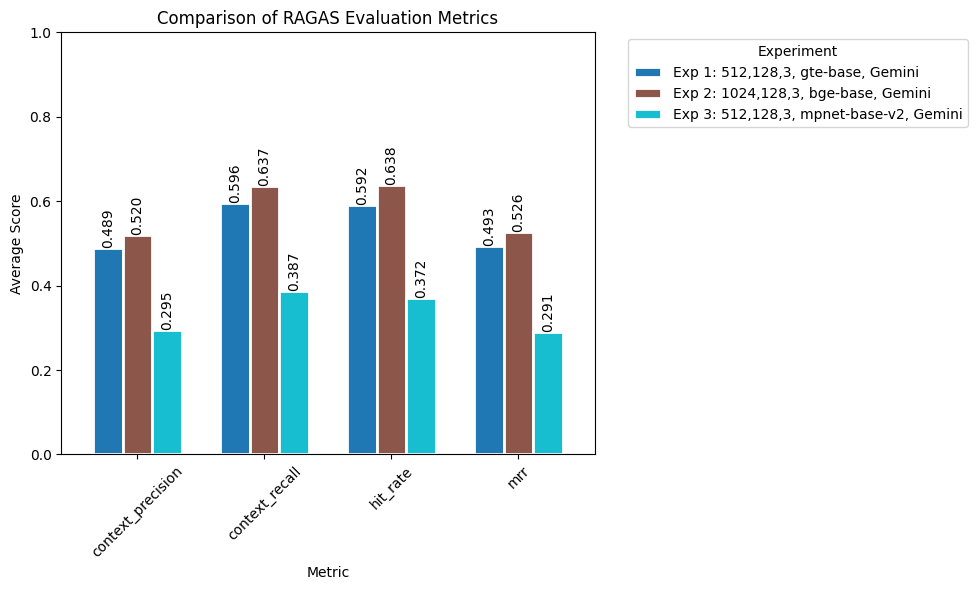

In [45]:
experiment_names = [
    "Exp 1: 512,128,3, gte-base, Gemini",
    "Exp 2: 1024,128,3, bge-base, Gemini",
    "Exp 3: 512,128,3, mpnet-base-v2, Gemini",

]
metrics_to_plot = ["context_precision", "context_recall", "hit_rate", "mrr"]

plot_experiment_comparison([experiment_1, experiment_2, experiment_3], experiment_names, metrics_to_plot)

In [35]:
experiment_1 = pd.read_csv("C:/Users/PC/CODE/WDM-AI-TEMIS/exps/experiment_512_128_bge-base-en_3_gemma.csv")
experiment_2 = pd.read_csv("C:/Users/PC/CODE/WDM-AI-TEMIS/exps/experiment_512_128_gte-base_3_gemma.csv")
experiment_3 = pd.read_csv("C:/Users/PC/CODE/WDM-AI-TEMIS/exps/experiment_512_128_paraphrase-multilingual-MiniLM-L12-v2_3_gemma.csv")

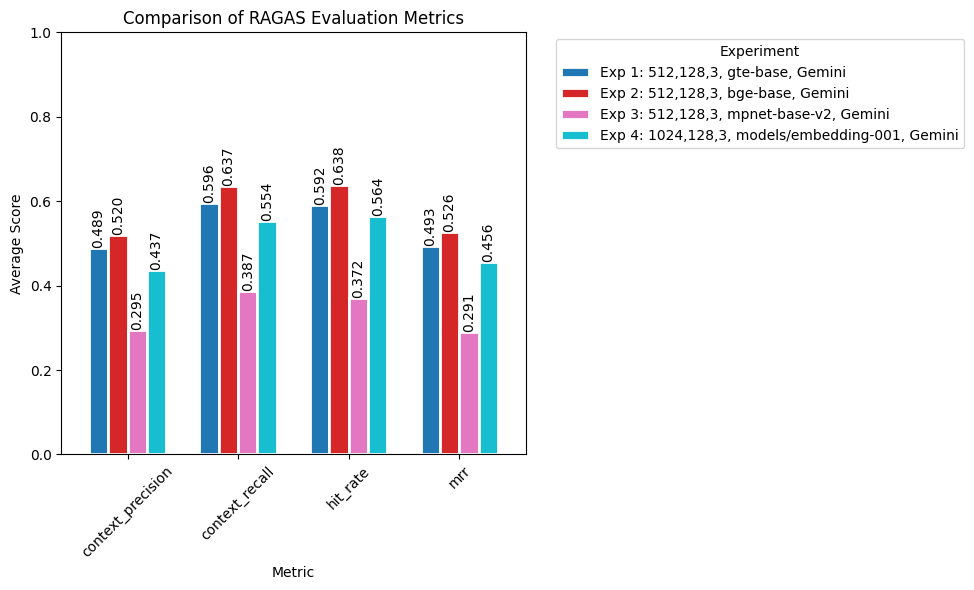

In [47]:
experiment_names = [
    "Exp 1: 512,128,3, gte-base, Gemini",
    "Exp 2: 512,128,3, bge-base, Gemini",
    "Exp 3: 512,128,3, mpnet-base-v2, Gemini",
    "Exp 4: 1024,128,3, models/embedding-001, Gemini"

]
metrics_to_plot = ["context_precision", "context_recall", "hit_rate", "mrr"]

plot_experiment_comparison([experiment_1, experiment_2, experiment_3, experiment_4], experiment_names, metrics_to_plot)

In [49]:
print(experiment_4.head(2)['retrieved_contexts'][0])
print(experiment_4.head(2)['reference_contexts'][0])

['| Symbol   | Description                                                    |\n|:---------|:---------------------------------------------------------------|\n| †        | Denotes film or TV productions that have not yet been released |', '| Symbol   | Description                    |\n|:---------|:-------------------------------|\n| ‡        | Indicates the winner           |\n| †        | Indicates a posthumous nominee |', 'Football and Heraldry"\n (PDF). The Coat of Arms. XI Part I (229): 40–43. Archived\n (PDF) from the original on\n24 December 2021. Retrieved 31 January 2022.\n105. ^ Angus, J. Keith (1879). The Sportsman\'s Year-Book for 1880. Cassell, Petter, Galpin & Co. p.\xa0182.\n106. ^ a b c d e f Barnes et al. (2001), p. 48.\n107. ^ "Adidas launches new United home kit for 2018/19"\n. Manchester United. 17 July 2018. Archived\n from the\noriginal on 17 July 2018. Retrieved 17 July 2018.\n108. ^ Ogden, Mark (26 August 2011). "Sir Alex Ferguson\'s ability to play the generat

### **Experiment 2 - Changing the num docs**



In [50]:
chunk_size = 512
chunk_overlap = 128
embedding_model_name = "BAAI/bge-base-en"
num_docs = 3

COLLECTION_NAME = f"experiment_{chunk_size}_{chunk_overlap}_{embedding_model_name.split('/')[1]}"

In [48]:
# experiment_1 = pd.read_csv(f"{exps_dir}/qdrant_client_memory/experiment_512_128_bge-base-en.csv")

In [51]:
experiment_1 = run_ragas_eval(eval_df,
                        collection_name=COLLECTION_NAME,
                        doc_retrieval_function=exp1.get_documents,
                        num_docs=num_docs,
                        embedding_model_name=embedding_model_name,
                        path=f"{exps_dir}/{COLLECTION_NAME}_{num_docs}_gemma.csv")


Running Context Retrieve...
Running Oputput Generate...
Running RAGAS evaluation...


Evaluating:   0%|          | 0/1690 [00:00<?, ?it/s]

Evaluation completed. Results saved to c:/Users/PC/CODE/WDM-AI-TEMIS/exps/experiment_512_128_bge-base-en_3_gemma.csv


In [52]:

chunk_size = 512
chunk_overlap = 128
embedding_model_name = "BAAI/bge-base-en"
num_docs = 5

COLLECTION_NAME = f"experiment_{chunk_size}_{chunk_overlap}_{embedding_model_name.split('/')[1]}"




In [53]:
experiment_2 = run_ragas_eval(eval_df,
                        collection_name=COLLECTION_NAME,
                        doc_retrieval_function=exp2.get_documents,
                        num_docs=num_docs,
                        embedding_model_name=embedding_model_name,
                        path=f"{exps_dir}/{COLLECTION_NAME}_{num_docs}_gemma.csv")


Running Context Retrieve...
Running Oputput Generate...
Running RAGAS evaluation...


Evaluating:   0%|          | 0/1690 [00:00<?, ?it/s]

Evaluation completed. Results saved to c:/Users/PC/CODE/WDM-AI-TEMIS/exps/experiment_512_128_bge-base-en_5_gemma.csv


In [54]:
chunk_size = 512
chunk_overlap = 128
embedding_model_name = "BAAI/bge-base-en"
num_docs = 7

COLLECTION_NAME = f"experiment_{chunk_size}_{chunk_overlap}_{embedding_model_name.split('/')[1]}"




In [55]:
experiment_3 = run_ragas_eval(eval_df,
                        collection_name=COLLECTION_NAME,
                        doc_retrieval_function=exp3.get_documents,
                        num_docs=num_docs,
                        embedding_model_name=embedding_model_name,
                        path=f"{exps_dir}/{COLLECTION_NAME}_{num_docs}_gemma.csv")


Running Context Retrieve...


Running Oputput Generate...
Running RAGAS evaluation...


Evaluating:   0%|          | 0/1690 [00:00<?, ?it/s]

Evaluation completed. Results saved to c:/Users/PC/CODE/WDM-AI-TEMIS/exps/experiment_512_128_bge-base-en_7_gemma.csv


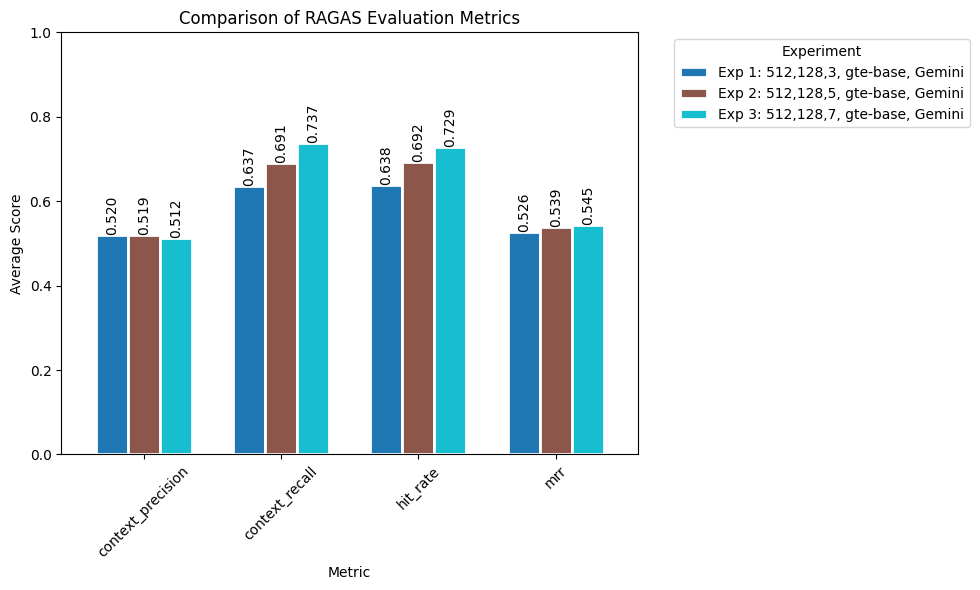

In [56]:
experiment_names = [
    "Exp 1: 512,128,3, gte-base, Gemini",
    "Exp 2: 512,128,5, gte-base, Gemini",
    "Exp 3: 512,128,7, gte-base, Gemini",

]
metrics_to_plot = ["context_precision", "context_recall", "hit_rate", "mrr"]

plot_experiment_comparison([experiment_1, experiment_2, experiment_3], experiment_names, metrics_to_plot)

### **Experiment 4 - Changing the chunking type**

Keeping all other parameters constant, we changed the **reranker ways**, such as using api, using words search, hybrid search to see if we can improve performance by providing more context.

This time, our RAG setup looks like:
- **Embeddings: `bge-small-en`**
- **Chunk size: `1024`**
- **Chunk overlap: `128`**
- **Number of docs: `3`**
- **Language model: `Gemini`**

In [59]:
chunk_size = 512
chunk_overlap = 128
embedding_model_name = "BAAI/bge-base-en"
num_docs = 7
chunk_type = "recursive"

COLLECTION_NAME = f"experiment_{chunk_size}_{chunk_overlap}_{embedding_model_name.split('/')[1]}_{chunk_type}"
exp1 = QdrantRAG(client=client)
exp1.add_documents(
              collection_name=COLLECTION_NAME,
              documents=all_page_documents,
              tables=all_table_documents,
              chunk_type=chunk_type,
              chunk_size=chunk_size,
              chunk_overlap=chunk_overlap,
              embedding_model_name=embedding_model_name)



In [60]:
experiment_1 = run_ragas_eval(eval_df,
                        collection_name=COLLECTION_NAME,
                        doc_retrieval_function=exp1.get_documents,
                        num_docs=num_docs,
                        embedding_model_name=embedding_model_name,
                        path=f"{exps_dir}/{COLLECTION_NAME}_{num_docs}_gemma.csv")

Running Context Retrieve...
Running Oputput Generate...
Running RAGAS evaluation...


Evaluating:   0%|          | 0/1690 [00:00<?, ?it/s]

Evaluation completed. Results saved to c:/Users/PC/CODE/WDM-AI-TEMIS/exps/experiment_512_128_bge-base-en_recursive_7_gemma.csv


In [61]:
chunk_size = 512
chunk_overlap = 128
embedding_model_name = "BAAI/bge-base-en"
num_docs = 7
chunk_type = "character"

COLLECTION_NAME = f"experiment_{chunk_size}_{chunk_overlap}_{embedding_model_name.split('/')[1]}_{chunk_type}"
exp2 = QdrantRAG(client=client)
exp2.add_documents(
              collection_name=COLLECTION_NAME,
              documents=all_page_documents,
              tables=all_table_documents,
              chunk_type=chunk_type,
              chunk_size=chunk_size,
              chunk_overlap=chunk_overlap,
              embedding_model_name=embedding_model_name)

In [62]:
experiment_2 = run_ragas_eval(eval_df,
                        collection_name=COLLECTION_NAME,
                        doc_retrieval_function=exp2.get_documents,
                        num_docs=num_docs,
                        embedding_model_name=embedding_model_name,
                        path=f"{exps_dir}/{COLLECTION_NAME}_{num_docs}_gemma.csv")

Running Context Retrieve...
Running Oputput Generate...
Running RAGAS evaluation...


Evaluating:   0%|          | 0/1690 [00:00<?, ?it/s]

Evaluation completed. Results saved to c:/Users/PC/CODE/WDM-AI-TEMIS/exps/experiment_512_128_bge-base-en_character_7_gemma.csv


In [63]:
chunk_size = 512
chunk_overlap = 128
embedding_model_name = "BAAI/bge-base-en"
num_docs = 7
chunk_type = "semantic"

COLLECTION_NAME = f"experiment_{chunk_size}_{chunk_overlap}_{embedding_model_name.split('/')[1]}_{chunk_type}"
exp3 = QdrantRAG(client=client)
exp3.add_documents(
              collection_name=COLLECTION_NAME,
              documents=all_page_documents,
              tables=all_table_documents,
              chunk_type=chunk_type,
              chunk_size=chunk_size,
              chunk_overlap=chunk_overlap,
              embedding_model_name=embedding_model_name)

c:\Users\PC\CODE\WDM-AI-TEMIS\utils\rag_qdrant_utils.py:39: LangChainDeprecationWarning: The class `HuggingFaceEmbeddings` was deprecated in LangChain 0.2.2 and will be removed in 1.0. An updated version of the class exists in the :class:`~langchain-huggingface package and should be used instead. To use it run `pip install -U :class:`~langchain-huggingface` and import as `from :class:`~langchain_huggingface import HuggingFaceEmbeddings``.
  embedding_model = HuggingFaceEmbeddings(model_name="sentence-transformers/all-MiniLM-L6-v2")


In [64]:
experiment_3 = run_ragas_eval(eval_df,
                        collection_name=COLLECTION_NAME,
                        doc_retrieval_function=exp3.get_documents,
                        num_docs=num_docs,
                        embedding_model_name=embedding_model_name,
                        path=f"{exps_dir}/{COLLECTION_NAME}_{num_docs}_gemma.csv")

Running Context Retrieve...
Running Oputput Generate...
Running RAGAS evaluation...


Evaluating:   0%|          | 0/1690 [00:00<?, ?it/s]

Evaluation completed. Results saved to c:/Users/PC/CODE/WDM-AI-TEMIS/exps/experiment_512_128_bge-base-en_semantic_7_gemma.csv


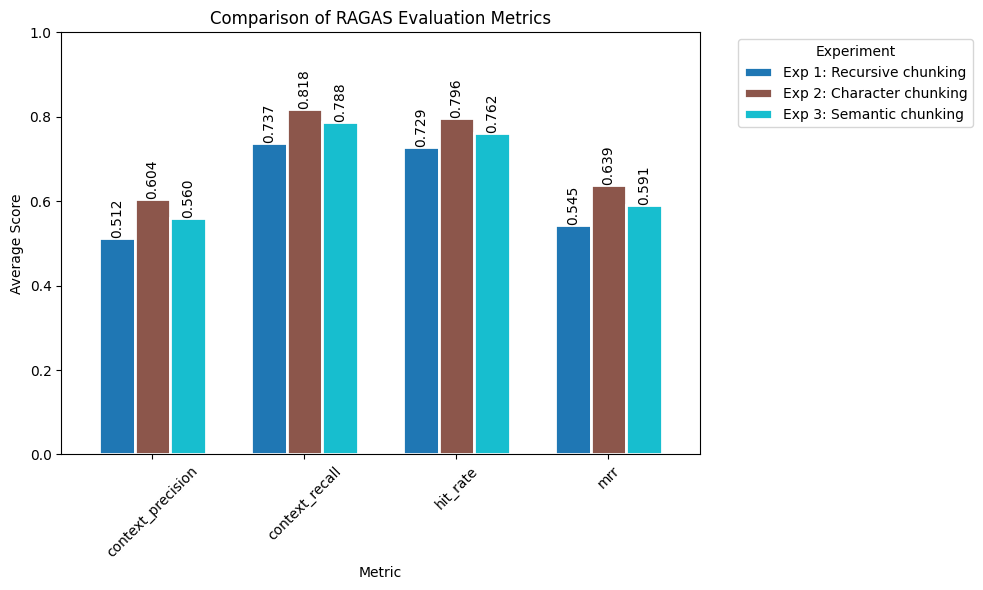

In [65]:
experiment_names = [
    "Exp 1: Recursive chunking",
    "Exp 2: Character chunking",
    "Exp 3: Semantic chunking",
]
metrics_to_plot = ["context_precision", "context_recall", "hit_rate", "mrr"]

plot_experiment_comparison([experiment_1, experiment_2, experiment_3], experiment_names, metrics_to_plot)

### **Experiment 5 - Add Hybrid search**

Keeping all other parameters constant, we changed the **reranker ways**, such as using api, using words search, hybrid search to see if we can improve performance by providing more context.

This time, our RAG setup looks like:
- **Embeddings: `bge-small-en`**
- **Chunk size: `1024`**
- **Chunk overlap: `128`**
- **Number of docs: `3`**
- **Language model: `Gemini`**

In [33]:
# ket qua tot nhat phia tren
chunk_size = 512
chunk_overlap = 128
embedding_model_name = "BAAI/bge-base-en"
num_docs = 7
chunk_type = "character"

COLLECTION_NAME = f"experiment_{chunk_size}_{chunk_overlap}_{embedding_model_name.split('/')[1]}_{chunk_type}"
experiment_nonhybrid = pd.read_csv(f"{exps_dir}/{COLLECTION_NAME}_{num_docs}_gemma.csv")

In [34]:

COLLECTION_NAME = f"experiment_hybrid_{chunk_size}_{chunk_overlap}_{embedding_model_name.split('/')[1]}_{chunk_type}"
# COLLECTION_NAME = f"experimenthybrid"
exp_hybrid = QdrantRAG(client=client)
exp_hybrid.add_documents_hybrid(
    collection_name=COLLECTION_NAME,
    documents=all_page_documents,
    tables=all_table_documents,
    chunk_type=chunk_type,
    chunk_size=chunk_size,
    chunk_overlap=chunk_overlap,
    embedding_model_name=embedding_model_name,
)

c:\Users\PC\CODE\WDM-AI-TEMIS\utils\rag_qdrant_utils.py:125: LangChainDeprecationWarning: The class `HuggingFaceEmbeddings` was deprecated in LangChain 0.2.2 and will be removed in 1.0. An updated version of the class exists in the :class:`~langchain-huggingface package and should be used instead. To use it run `pip install -U :class:`~langchain-huggingface` and import as `from :class:`~langchain_huggingface import HuggingFaceEmbeddings``.
  dense_embeddings = HuggingFaceEmbeddings(model_name=embedding_model_name, model_kwargs={"device": device})


Fetching 18 files:   0%|          | 0/18 [00:00<?, ?it/s]

config.json:   0%|          | 0.00/2.00 [00:00<?, ?B/s]

dutch.txt:   0%|          | 0.00/453 [00:00<?, ?B/s]

arabic.txt:   0%|          | 0.00/6.35k [00:00<?, ?B/s]

finnish.txt:   0%|          | 0.00/1.58k [00:00<?, ?B/s]

german.txt:   0%|          | 0.00/1.36k [00:00<?, ?B/s]

danish.txt:   0%|          | 0.00/424 [00:00<?, ?B/s]

c:\Users\PC\CODE\WDM-AI-TEMIS\.venv\lib\site-packages\huggingface_hub\file_download.py:143: UserWarning: `huggingface_hub` cache-system uses symlinks by default to efficiently store duplicated files but your machine does not support them in C:\Users\PC\AppData\Local\Temp\fastembed_cache\models--Qdrant--bm25. Caching files will still work but in a degraded version that might require more space on your disk. This warning can be disabled by setting the `HF_HUB_DISABLE_SYMLINKS_WARNING` environment variable. For more details, see https://huggingface.co/docs/huggingface_hub/how-to-cache#limitations.
To support symlinks on Windows, you either need to activate Developer Mode or to run Python as an administrator. In order to activate developer mode, see this article: https://docs.microsoft.com/en-us/windows/apps/get-started/enable-your-device-for-development
  warnings.warn(message)


french.txt:   0%|          | 0.00/813 [00:00<?, ?B/s]

english.txt:   0%|          | 0.00/936 [00:00<?, ?B/s]

greek.txt:   0%|          | 0.00/2.17k [00:00<?, ?B/s]

hungarian.txt:   0%|          | 0.00/1.23k [00:00<?, ?B/s]

portuguese.txt:   0%|          | 0.00/1.29k [00:00<?, ?B/s]

italian.txt:   0%|          | 0.00/1.65k [00:00<?, ?B/s]

norwegian.txt:   0%|          | 0.00/851 [00:00<?, ?B/s]

2025-06-16 15:03:40.297 | ERROR    | fastembed.common.model_management:download_model:430 - Could not download model from HuggingFace: [WinError 1314] A required privilege is not held by the client: '..\\..\\blobs\\9e26dfeeb6e641a33dae4961196235bdb965b21b' -> 'C:\\Users\\PC\\AppData\\Local\\Temp\\fastembed_cache\\models--Qdrant--bm25\\snapshots\\e499a1f8d6bec960aab5533a0941bf914e70faf9\\config.json' Falling back to other sources.
2025-06-16 15:03:40.300 | ERROR    | fastembed.common.model_management:download_model:452 - Could not download model from either source, sleeping for 3.0 seconds, 2 retries left.


Fetching 18 files:   0%|          | 0/18 [00:00<?, ?it/s]

turkish.txt:   0%|          | 0.00/260 [00:00<?, ?B/s]

spanish.txt:   0%|          | 0.00/2.18k [00:00<?, ?B/s]

swedish.txt:   0%|          | 0.00/559 [00:00<?, ?B/s]

romanian.txt:   0%|          | 0.00/1.91k [00:00<?, ?B/s]

russian.txt:   0%|          | 0.00/1.24k [00:00<?, ?B/s]

In [35]:
experiment_hybrid = run_ragas_eval(eval_df,
                        collection_name=COLLECTION_NAME,
                        doc_retrieval_function=exp_hybrid.get_documents_hybrid,
                        num_docs=num_docs,
                        embedding_model_name=embedding_model_name,
                        path=f"{exps_dir}/{COLLECTION_NAME}_{num_docs}_gemma.csv")

Running Context Retrieve...
Running Oputput Generate...
Running RAGAS evaluation...


Evaluating:   0%|          | 0/1690 [00:00<?, ?it/s]

Failed to multipart ingest runs: langsmith.utils.LangSmithRateLimitError: Rate limit exceeded for https://api.smith.langchain.com/runs/multipart. HTTPError('429 Client Error: Too Many Requests for url: https://api.smith.langchain.com/runs/multipart', '{"error":"Too many requests: tenant exceeded usage limits: Monthly unique traces usage limit exceeded"}\n')trace=e22f77e0-c7e4-4f57-986b-2047e3ad33d5,id=e22f77e0-c7e4-4f57-986b-2047e3ad33d5; trace=e22f77e0-c7e4-4f57-986b-2047e3ad33d5,id=3b09f5c4-6903-40d7-a6c5-3db993d15971; trace=e22f77e0-c7e4-4f57-986b-2047e3ad33d5,id=a69be70a-1e67-4111-b38a-8055c0177360; trace=e22f77e0-c7e4-4f57-986b-2047e3ad33d5,id=10aff854-d677-42ea-b150-736c6fd20014; trace=e22f77e0-c7e4-4f57-986b-2047e3ad33d5,id=4c5afa6c-50d9-42a2-81d7-a882d2a65a22; trace=e22f77e0-c7e4-4f57-986b-2047e3ad33d5,id=32eafd95-a2e1-424a-9d92-81615789542b; trace=e22f77e0-c7e4-4f57-986b-2047e3ad33d5,id=f45abb50-5bdf-4609-b45e-32ffc0f1d11d; trace=e22f77e0-c7e4-4f57-986b-2047e3ad33d5,id=e89e68b

Evaluation completed. Results saved to c:/Users/PC/CODE/WDM-AI-TEMIS/exps/experiment_hybrid_512_128_bge-base-en_character_7_gemma.csv


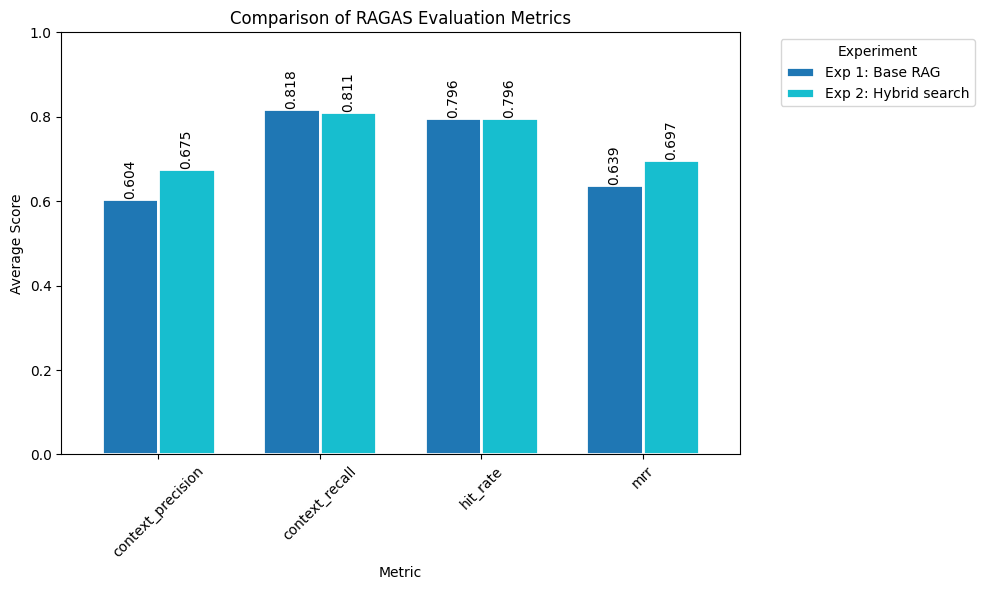

In [36]:
experiment_names = [
    "Exp 1: Base RAG",
    "Exp 2: Hybrid search"
]
metrics_to_plot = ["context_precision", "context_recall", "hit_rate", "mrr"]

plot_experiment_comparison([experiment_nonhybrid, experiment_hybrid], experiment_names, metrics_to_plot)

### **Experiment 6 - Changing the reranker document**

Keeping all other parameters constant, we changed the **reranker ways**, such as using api, using words search, hybrid search to see if we can improve performance by providing more context.

This time, our RAG setup looks like:
- **Embeddings: `bge-small-en`**
- **Chunk size: `1024`**
- **Chunk overlap: `128`**
- **Number of docs: `3`**
- **Language model: `Gemini`**

In [33]:
from utils.reranker_utils import *
reranker = Reranker(method="jina")

06/21/2025 23:13:15 - [INFO] -BCEmbedding.models.RerankerModel->>>    Loading from `maidalun1020/bce-reranker-base_v1`.
06/21/2025 23:13:15 - [INFO] -BCEmbedding.models.RerankerModel->>>    Execute device: cuda;	 gpu num: 1;	 use fp16: True
c:\Users\Admin\Data\WDM-AI-TEMIS\.venv\lib\site-packages\FlagEmbedding\inference\reranker\decoder_only\layerwise.py:114: UserWarning: Due to model constraints, `use_bf16` and `use_fp16` cannot both be `False`. Here, `use_fp16` is set to `True` by default.
  warnings.warn("Due to model constraints, `use_bf16` and `use_fp16` cannot both be `False`. Here, `use_fp16` is set to `True` by default.", UserWarning)
LayerWiseMiniCPMForCausalLM has generative capabilities, as `prepare_inputs_for_generation` is explicitly defined. However, it doesn't directly inherit from `GenerationMixin`. From 👉v4.50👈 onwards, `PreTrainedModel` will NOT inherit from `GenerationMixin`, and this model will lose the ability to call `generate` and other related functions.
  - If 

In [36]:
chunk_size = 512
chunk_overlap = 128
embedding_model_name = "BAAI/bge-base-en"
num_docs = 7
chunk_type = "character"

COLLECTION_NAME = f"experiment_hybrid_{chunk_size}_{chunk_overlap}_{embedding_model_name.split('/')[1]}_{chunk_type}"
# COLLECTION_NAME = f"experimenthybrid"
exp_hybrid = QdrantRAG(client=client)
exp_hybrid.add_documents_hybrid(
    collection_name=COLLECTION_NAME,
    documents=all_page_documents,
    tables=all_table_documents,
    chunk_type=chunk_type,
    chunk_size=chunk_size,
    chunk_overlap=chunk_overlap,
    embedding_model_name=embedding_model_name,
)



c:\Users\Admin\Data\WDM-AI-TEMIS\utils\rag_qdrant_utils.py:125: LangChainDeprecationWarning: The class `HuggingFaceEmbeddings` was deprecated in LangChain 0.2.2 and will be removed in 1.0. An updated version of the class exists in the :class:`~langchain-huggingface package and should be used instead. To use it run `pip install -U :class:`~langchain-huggingface` and import as `from :class:`~langchain_huggingface import HuggingFaceEmbeddings``.
  dense_embeddings = HuggingFaceEmbeddings(model_name=embedding_model_name, model_kwargs={"device": device})
06/22/2025 00:43:49 - [INFO] -sentence_transformers.SentenceTransformer->>>    Load pretrained SentenceTransformer: BAAI/bge-base-en


In [35]:
experiment_jina = run_ragas_eval(
                        eval_df =eval_df,
                        collection_name=COLLECTION_NAME,
                        doc_retrieval_function=exp_hybrid.get_documents_hybrid,
                        num_docs=num_docs,
                        embedding_model_name=embedding_model_name,
                        path=f"{COLLECTION_NAME}_{num_docs}_jina_gemma.csv",
                        reranker_function=reranker)

Running Context Retrieve...
Running Oputput Generate...
Running RAGAS evaluation...


Batches: 100%|██████████| 1/1 [00:00<00:00, 247.22it/s]


Evaluation completed. Results saved to experiment_hybrid_512_128_bge-base-en_character_7_jina_gemma.csv


In [ ]:
reranker = Reranker(method="mixedbread")
experiment_mixbread = run_ragas_eval(
                                     eval_df,
                        collection_name=COLLECTION_NAME,
                        doc_retrieval_function=exp_hybrid.get_documents_hybrid,
                        num_docs=num_docs,
                        embedding_model_name=embedding_model_name,
                        path=f"{COLLECTION_NAME}_{num_docs}_mixedbread_gemma.csv",
                        reranker_function=reranker)

Running Context Retrieve...


06/07/2025 20:20:27 - [INFO] -httpx->>>    HTTP Request: POST https://api.mixedbread.com/v1/reranking "HTTP/1.1 200 OK"
06/07/2025 20:20:29 - [INFO] -httpx->>>    HTTP Request: POST https://api.mixedbread.com/v1/reranking "HTTP/1.1 200 OK"
06/07/2025 20:20:31 - [INFO] -httpx->>>    HTTP Request: POST https://api.mixedbread.com/v1/reranking "HTTP/1.1 200 OK"
06/07/2025 20:20:32 - [INFO] -httpx->>>    HTTP Request: POST https://api.mixedbread.com/v1/reranking "HTTP/1.1 200 OK"
06/07/2025 20:20:34 - [INFO] -httpx->>>    HTTP Request: POST https://api.mixedbread.com/v1/reranking "HTTP/1.1 200 OK"
06/07/2025 20:20:35 - [INFO] -httpx->>>    HTTP Request: POST https://api.mixedbread.com/v1/reranking "HTTP/1.1 200 OK"
06/07/2025 20:20:36 - [INFO] -httpx->>>    HTTP Request: POST https://api.mixedbread.com/v1/reranking "HTTP/1.1 200 OK"
06/07/2025 20:20:38 - [INFO] -httpx->>>    HTTP Request: POST https://api.mixedbread.com/v1/reranking "HTTP/1.1 200 OK"
06/07/2025 20:20:39 - [INFO] -httpx->>> 

Running Oputput Generate...
Running RAGAS evaluation...


Batches: 100%|██████████| 1/1 [00:00<00:00, 24.57it/s]


Evaluation completed. Results saved to experiment_512_128_gte-base_7_gemma.csv


In [ ]:
reranker = Reranker(method="cohere")

experiment_cohere = run_ragas_eval(
                                   eval_df,
                        collection_name=COLLECTION_NAME,
                        doc_retrieval_function=exp_hybrid.get_documents_hybrid(reranker=reranker),
                        num_docs=num_docs,
                        embedding_model_name=embedding_model_name,
                        path=f"{COLLECTION_NAME}_{num_docs}_cohere_gemma.csv",
                        reranker_function=reranker)

Running Context Retrieve...


06/07/2025 21:07:42 - [INFO] -httpx->>>    HTTP Request: POST https://api.cohere.com/v2/rerank "HTTP/1.1 200 OK"
06/07/2025 21:07:49 - [INFO] -httpx->>>    HTTP Request: POST https://api.cohere.com/v2/rerank "HTTP/1.1 200 OK"
06/07/2025 21:07:57 - [INFO] -httpx->>>    HTTP Request: POST https://api.cohere.com/v2/rerank "HTTP/1.1 200 OK"
06/07/2025 21:08:04 - [INFO] -httpx->>>    HTTP Request: POST https://api.cohere.com/v2/rerank "HTTP/1.1 200 OK"
06/07/2025 21:08:12 - [INFO] -httpx->>>    HTTP Request: POST https://api.cohere.com/v2/rerank "HTTP/1.1 200 OK"
06/07/2025 21:08:19 - [INFO] -httpx->>>    HTTP Request: POST https://api.cohere.com/v2/rerank "HTTP/1.1 200 OK"
06/07/2025 21:08:28 - [INFO] -httpx->>>    HTTP Request: POST https://api.cohere.com/v2/rerank "HTTP/1.1 200 OK"
06/07/2025 21:08:35 - [INFO] -httpx->>>    HTTP Request: POST https://api.cohere.com/v2/rerank "HTTP/1.1 200 OK"
06/07/2025 21:08:43 - [INFO] -httpx->>>    HTTP Request: POST https://api.cohere.com/v2/rerank "

Running Oputput Generate...
Running RAGAS evaluation...


Batches: 100%|██████████| 1/1 [00:00<00:00, 22.73it/s]


Evaluation completed. Results saved to experiment_512_128_gte-base_7_gemma.csv


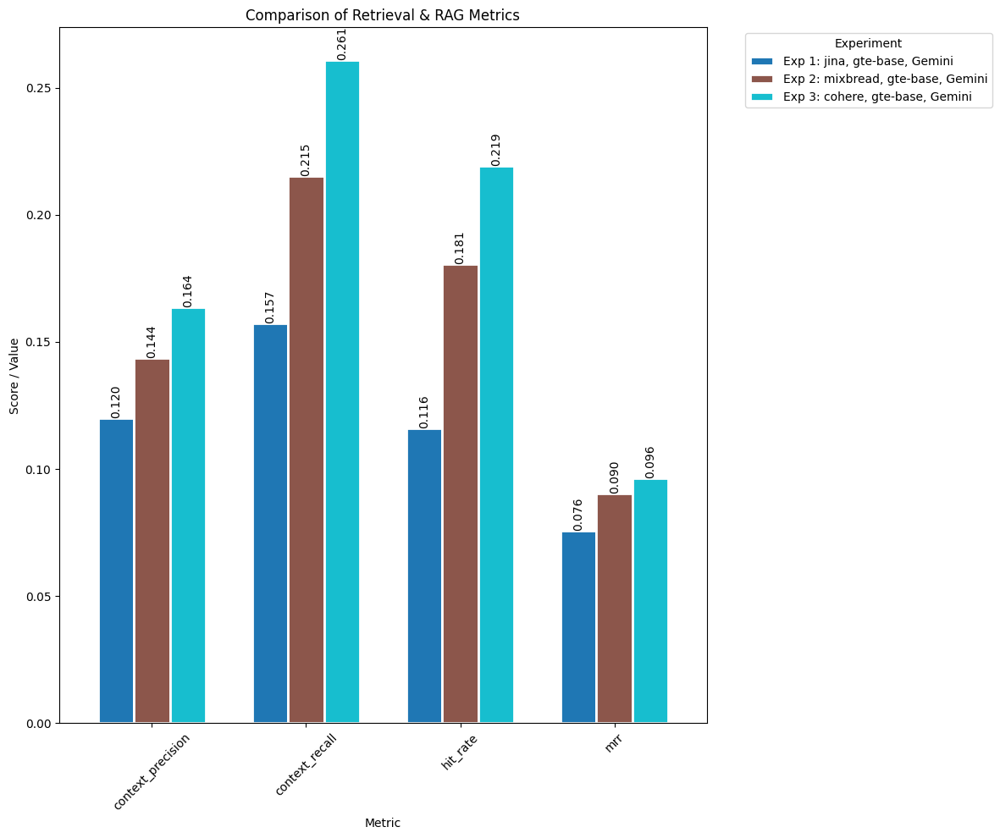

In [89]:
experiment_names = [
    "Exp 1: jina, gte-base, Gemini",
    "Exp 2: mixbread, gte-base, Gemini",
    "Exp 3: cohere, gte-base, Gemini",

]
metrics_to_plot = ["context_precision", "context_recall", "hit_rate", "mrr"]

plot_experiment_comparison([experiment_1, experiment_2, experiment_3], experiment_names, metrics_to_plot)

##### **Using Open source Reranker**

In [36]:
import torch
if torch.cuda.is_available():
    print("CUDA is available. Using GPU for computations.")

CUDA is available. Using GPU for computations.


In [ ]:
chunk_size = 512
chunk_overlap = 128
embedding_model_name = "BAAI/bge-base-en"
num_docs = 7
chunk_type = "character"

COLLECTION_NAME = f"experiment_hybrid_{chunk_size}_{chunk_overlap}_{embedding_model_name.split('/')[1]}_{chunk_type}"

In [ ]:
reranker = Reranker(method="bce")
experiment_1 = run_ragas_eval(
                              eval_df,
                        collection_name=COLLECTION_NAME,
                        doc_retrieval_function=exp_hybrid.get_documents_hybrid,
                        num_docs=num_docs,
                        embedding_model_name=embedding_model_name,
                        path=f"{COLLECTION_NAME}_{num_docs}_bce_gemma.csv",
                        reranker_function=reranker)

Running Context Retrieve...


Calculate scores: 100%|██████████| 1/1 [00:00<00:00, 44.11it/s]


Running Oputput Generate...
Running RAGAS evaluation...


Batches: 100%|██████████| 1/1 [00:00<00:00, 181.28it/s]


Evaluation completed. Results saved to experiment_512_128_gte-base_7_gemma.csv


In [ ]:
reranker = Reranker(method="pretrained_bge")

experiment_2 = run_ragas_eval(
                        eval_df,
                        collection_name=COLLECTION_NAME,
                        doc_retrieval_function=exp_hybrid.get_documents_hybrid,
                        num_docs=num_docs,
                        embedding_model_name=embedding_model_name,
                        path=f"{COLLECTION_NAME}_{num_docs}_colbert_gemma.csv",
                        reranker_function=reranker)

Running Context Retrieve...


You're using a LlamaTokenizerFast tokenizer. Please note that with a fast tokenizer, using the `__call__` method is faster than using a method to encode the text followed by a call to the `pad` method to get a padded encoding.
100%|██████████| 1/1 [00:01<00:00,  1.75s/it]


Running Oputput Generate...
Running RAGAS evaluation...


Batches: 100%|██████████| 1/1 [00:00<00:00, 124.63it/s]


Evaluation completed. Results saved to experiment_512_128_gte-base_7_gemma.csv


In [ ]:
reranker = Reranker(method="finetune_bge")

experiment_3 = run_ragas_eval(
                              eval_df,
                        collection_name=COLLECTION_NAME,
                        doc_retrieval_function=exp_hybrid.get_documents_hybrid,
                        num_docs=num_docs,
                        embedding_model_name=embedding_model_name,
                        path=f"{COLLECTION_NAME}_{num_docs}_crossencoder_gemma.csv",
                        reranker_function=reranker)

Running Context Retrieve...
Running Oputput Generate...
Running RAGAS evaluation...


Batches: 100%|██████████| 1/1 [00:00<00:00, 166.16it/s]


Evaluation completed. Results saved to experiment_512_128_gte-base_7_flashrank_gemma.csv


In [ ]:
reranker = Reranker(method="flashrank")

experiment_4 = run_ragas_eval(
                              eval_df,
                        collection_name=COLLECTION_NAME,
                        doc_retrieval_function=exp_hybrid.get_documents_hybrid,
                        num_docs=num_docs,
                        embedding_model_name=embedding_model_name,
                        path=f"{COLLECTION_NAME}_{num_docs}_crossencoder_gemma.csv",
                        reranker_function=reranker)

In [ ]:
reranker = Reranker(method="st-crossencoder")

experiment_5 = run_ragas_eval(
                              eval_df,
                        collection_name=COLLECTION_NAME,
                        doc_retrieval_function=exp_hybrid.get_documents_hybrid,
                        num_docs=num_docs,
                        embedding_model_name=embedding_model_name,
                        path=f"{COLLECTION_NAME}_{num_docs}_crossencoder_gemma.csv",
                        reranker_function=reranker)

Running Context Retrieve...


Batches: 100%|██████████| 1/1 [00:00<00:00, 124.52it/s]


Running Oputput Generate...
Running RAGAS evaluation...


Batches: 100%|██████████| 1/1 [00:00<00:00, 203.76it/s]


Evaluation completed. Results saved to experiment_512_128_gte-base_7_crossencoder_gemma.csv


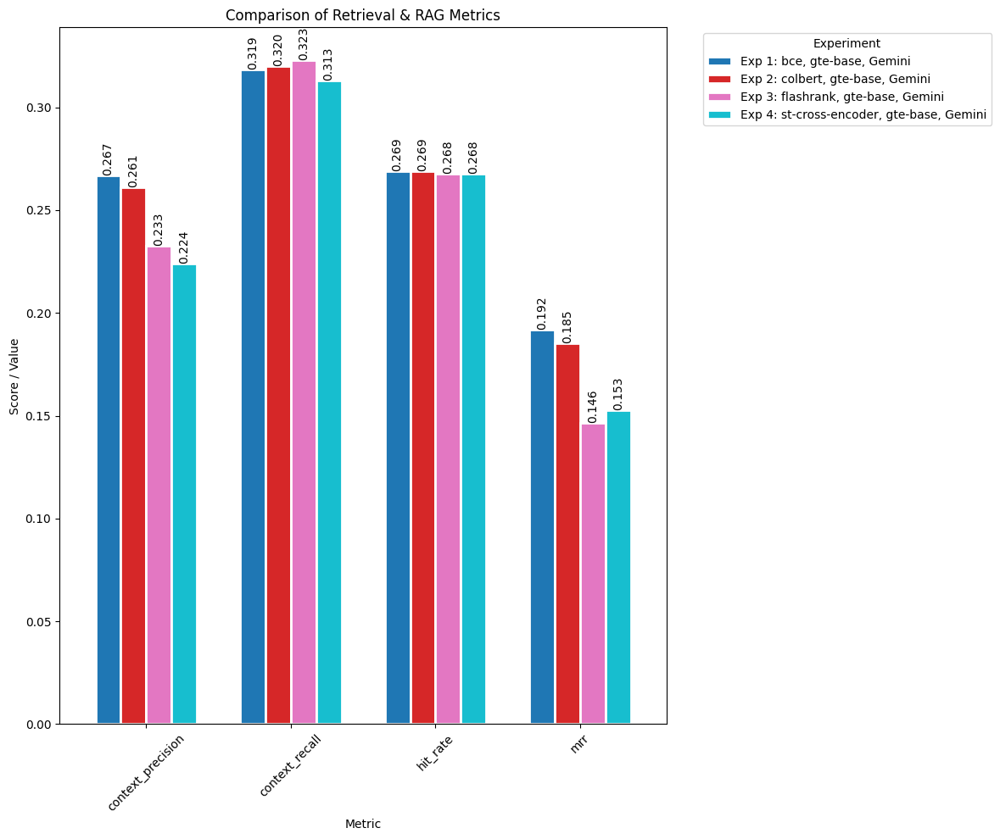

In [ ]:
experiment_names = [
    "Exp 1: bce, gte-base, Gemini",
    "Exp 2: bge_pretrained, gte-base, Gemini",
    "Exp 2: bge_finetune, gte-base, Gemini",
    "Exp 3: flashrank, gte-base, Gemini",
    "Exp 4: st-cross-encoder, gte-base, Gemini"
]
metrics_to_plot = ["context_precision", "context_recall", "hit_rate", "mrr"]

plot_experiment_comparison([experiment_1, experiment_2, experiment_3, experiment_4], experiment_names, metrics_to_plot)

##### **Using Hybrid Search Reranker**